In [1]:
pip install opencv-python


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [16]:
import cv2
import matplotlib.pyplot as plt
import colorsys
import numpy as np
import glob 

In [132]:
def capture(num_cam,name):
    '''
    This function is used to take the image by using the camera
    with num_cam and converted the colorstyle from BGR to RGB
    '''
    # Open the webcam
    cam2 = cv2.VideoCapture(num_cam)

    # Disable auto-exposure
    # cam2.set(cv2.CAP_PROP_AUTO_EXPOSURE, 100)
    # cam2.set(cv2.CAP_PROP_AUTO_EXPOSURE, 0)
    cam2.set(cv2.CAP_PROP_EXPOSURE, .000005)
    cam2.set(cv2.CAP_PROP_GAIN, 10.0001)
    cam2.set(cv2.CAP_PROP_GAMMA, 0.5)

    # Read a frame from the webcam
    result2, image2 = cam2.read()
    
    
    # Display the image using Matplotlib
    plt.figure()
    gray = cv2.cvtColor(image2,cv2.COLOR_BGR2GRAY)
    plt.imshow(gray,cmap='gray')
    plt.show()
    
    from PIL import Image

    image22 = Image.fromarray(gray,'L')
    image22.save(name)
    # Release the webcam
    cam2.release()
    
    return image2

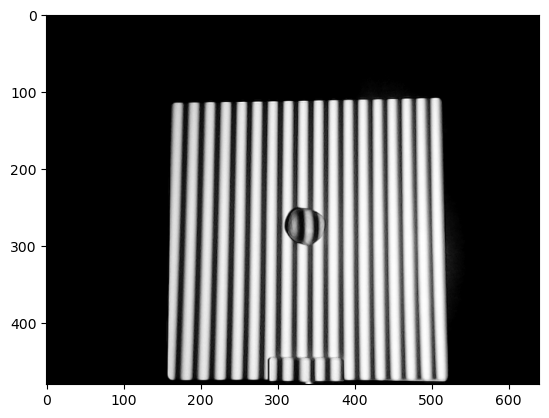

In [667]:
# take images with different patterns (phase)
image1 = capture(1,'image1.tiff')


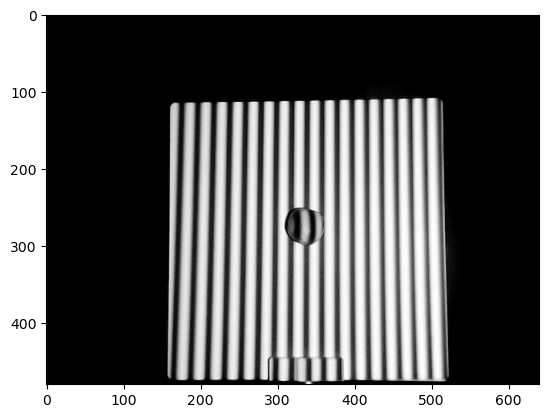

In [668]:
image2 = capture(1,'image2.tiff')

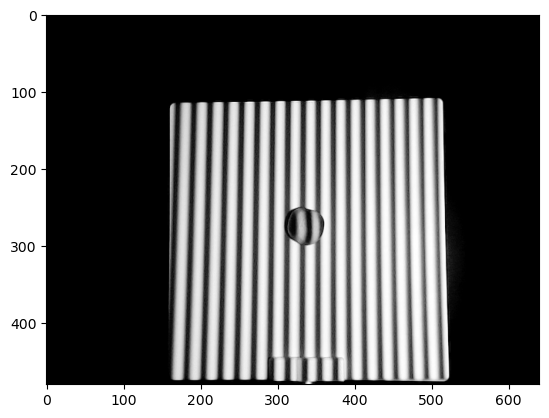

In [672]:
image3 = capture(1,'image3.tiff')

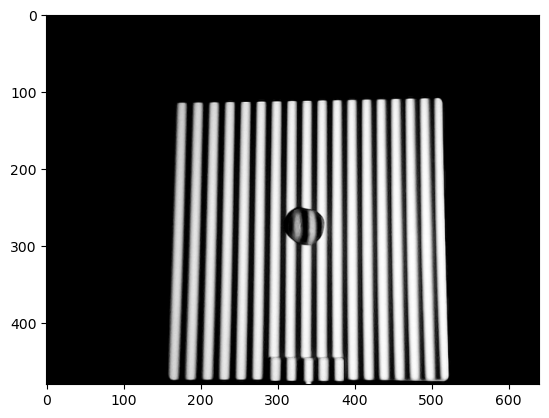

In [670]:
image4 = capture(1,'image4.tiff')

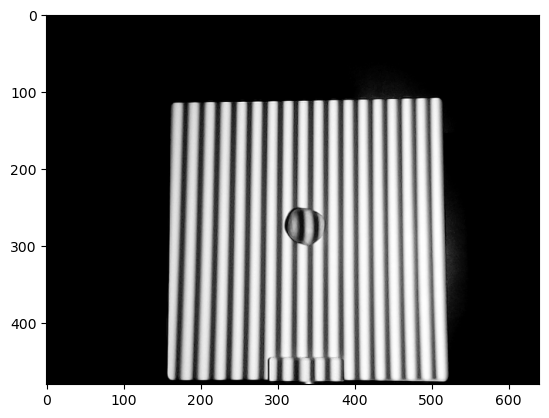

In [671]:
image5 = capture(1,'image5.tiff')

In [673]:
# save the images pixel values
# RUN at the end of session
np.save(r'data/data_1103_2/image1.npy',image1)
np.save(r'data/data_1103_2/image2.npy',image2)
np.save(r'data/data_1103_2/image3.npy',image3)
np.save(r'data/data_1103_2/image4.npy',image4)
np.save(r'data/data_1103_2/image5.npy',image5)

In [3]:
def load(file_path):
    '''
    this function is used to load the image data file from specific file path
    '''
    image  = np.load(file_path)
    return image

In [247]:
# load the five images file
image1 = load(r'data/data_2602/image1.npy')
image2 = load(r'data/data_2602/image2.npy')
image3 = load(r'data/data_2602/image3.npy')
image4 = load(r'data/data_2602/image4.npy')
image5 = load(r'data/data_2602/image5.npy')

In [258]:
# load the five images file
image1 = load(r'data/data_1103/image1.npy')
image2 = load(r'data/data_1103/image2.npy')
image3 = load(r'data/data_1103/image3.npy')
image4 = load(r'data/data_1103/image4.npy')
image5 = load(r'data/data_1103/image5.npy')

In [259]:
print(np.mean(image1, axis=(0,1)))
print(np.mean(image2, axis=(0,1)))
print(np.mean(image3, axis=(0,1)))
print(np.mean(image4, axis=(0,1)))
print(np.mean(image5, axis=(0,1)))

[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]


In [260]:
# normalisation of the images
image1 = (image1 / np.mean(image1, axis=(0,1))) * 40 / 255
image2 = (image2 / np.mean(image2, axis=(0,1))) * 40 / 255
image3 = (image3 / np.mean(image3, axis=(0,1))) * 40 / 255
image4 = (image4 / np.mean(image4, axis=(0,1))) * 40 / 255
image5 = (image5 / np.mean(image5, axis=(0,1))) * 40 / 255

In [261]:
# check normalisation
print(np.mean(image1, axis=(0,1)))
print(np.mean(image2, axis=(0,1)))
print(np.mean(image3, axis=(0,1)))
print(np.mean(image4, axis=(0,1)))
print(np.mean(image5, axis=(0,1)))

[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]
[0.15686275 0.15686275 0.15686275]


In [262]:
def crop(image):
    '''
    this function is defined to crop the image into the size of [125:440,90:425]
    '''
    return image[130:400,165:500]
#     return image[130:400,80:415]

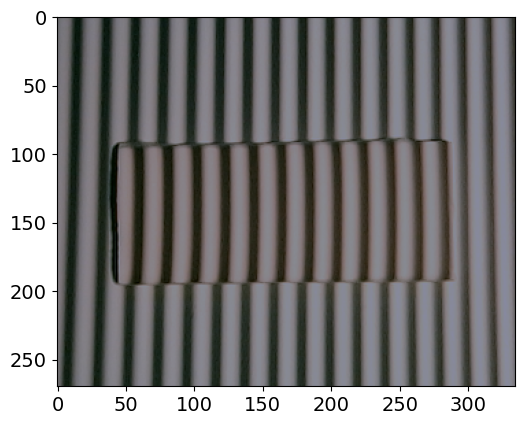

In [263]:
plt.figure()
plt.imshow(crop(image5))
plt.savefig('img1.png')

In [264]:
image1crop = crop(image1)
image2crop = crop(image2)
image3crop = crop(image3)
image4crop = crop(image4)
image5crop = crop(image5)

In [265]:
def rgb2hsv(x,y,image):
    '''
    this function is used to convert the colorstyle from rgb to hsv.
    '''
    return colorsys.rgb_to_hsv(image[x,y,:][0],image[x,y,:][1],image[x,y,:][2])
    
    

In [266]:
def cal_v(image):
    '''
    this function is used to calculate the intensity for each pixel
    '''
    v = np.zeros((335,270))
    for i in range (len(image[:,0,0])):
        for j in range (len(image[0,:,0])):
            v[j,i] = rgb2hsv(i,j,image)[2]
    return v.T

In [267]:
# calculate the intensity for each images
I_1 = cal_v(image1crop)
I_2 = cal_v(image2crop)
I_3 = cal_v(image3crop)
I_4 = cal_v(image4crop)
I_5 = cal_v(image5crop)


In [274]:
def fix(I_n):
    '''
    This function is designed to alter an image matrix by correcting specific pixel values.
    It locates pixels that are below a minimum threshold (normalized against the maximum value)
    and above a certain maximum value, adjusting these pixel values for visualization or further analysis.
    
    Parameters:
    I_n (numpy.ndarray): The input image matrix.
    
    Returns:
    numpy.ndarray: The corrected image matrix.
    '''

    # Create a copy of the input matrix to avoid modifying the original data
    I = I_n.copy()
    
    # Find indices of pixels below the threshold (less than max value divided by 255)
    j = np.where(I < I.max()/255)
    
    
    # Plot locations of these pixels for visualization
    plt.figure()
    plt.plot(j[1], j[0], '.', c='r', label='Below threshold')  # Marked in red
    plt.legend()
    
    # Correct the pixels below threshold by assuming horizontal adjacency,
    # replacing their value with the pixel value three positions to the left.
    for index in zip(j[0], j[1]):
        if index[1]+2 < I.shape[1]:  # Ensure the new index does not go out of bounds
            I[index] = I[index[0], index[1]-3]
        else:
            # For pixels at the edge (no next pixel), copy the value from three positions to the left
            I[index] = I[index[0], index[1]-3]
            
    # Display the corrected image
    plt.imshow(I, cmap='gray')
    
    return I

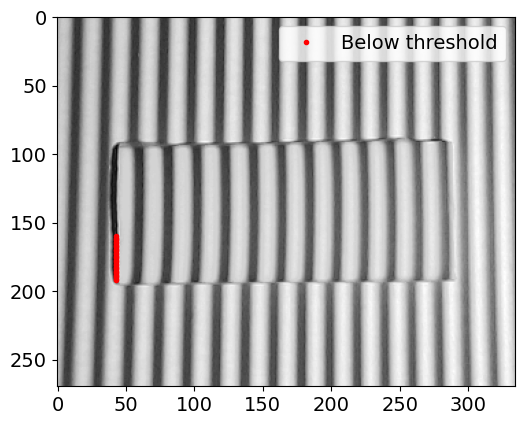

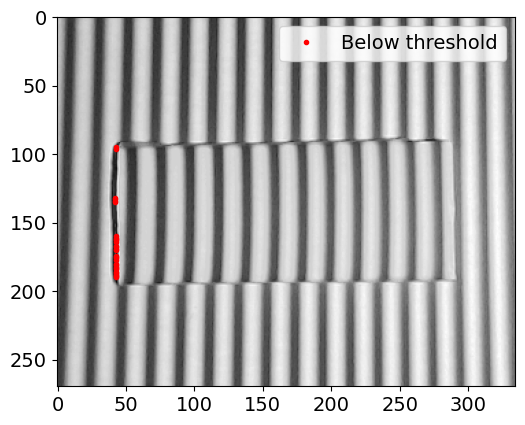

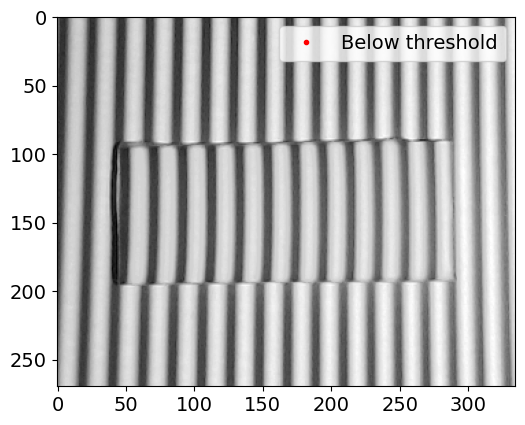

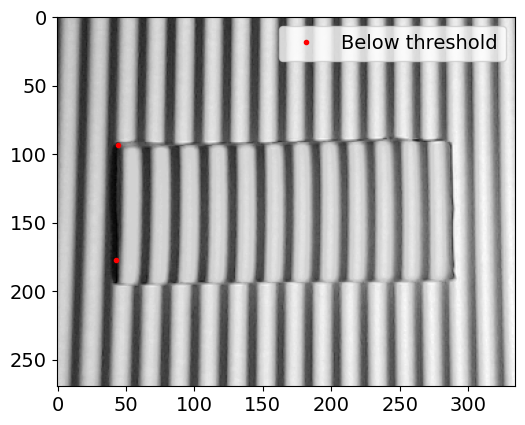

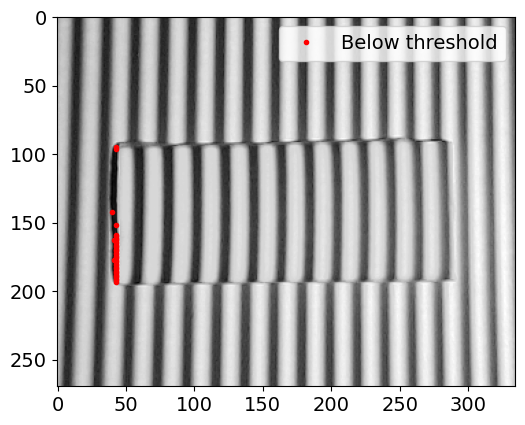

In [275]:
# fix the shadow problem
I1 = fix(I_1)
I2 = fix(I_2)
I3 = fix(I_3)
I4 = fix(I_4)
I5 = fix(I_5)


In [276]:
# 5-step phase stepping interferometry
phi=np.arctan2(2*(I_2-I_4),(2*I3-I1-I5))

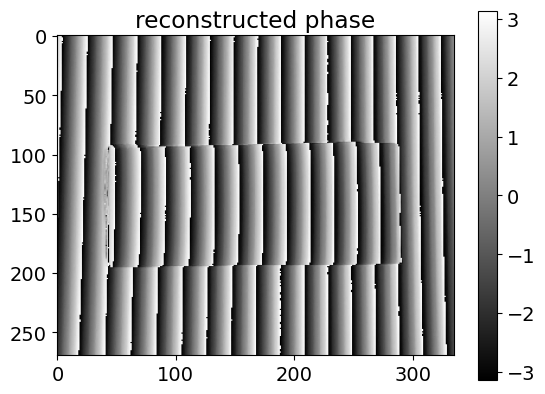

In [282]:

from mpl_toolkits.axes_grid1 import make_axes_locatable
# visualise the reconstructed phase
plt.figure()

plt.imshow(phi,cmap='gray')
plt.title('reconstructed phase')
plt.axis('on')

# Create a colorbar in the appended axes
plt.colorbar()

plt.savefig('b_phase.png')

<Figure size 640x480 with 0 Axes>

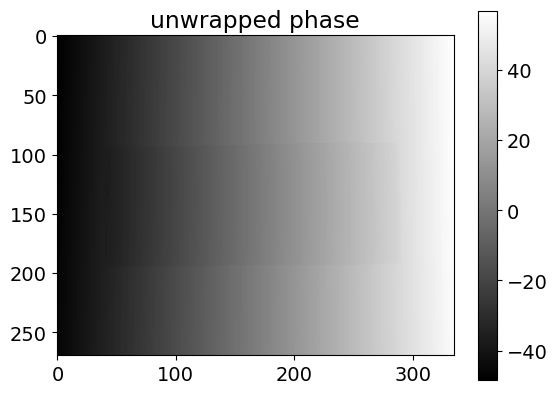

<Figure size 640x480 with 0 Axes>

In [283]:
Nx = phi.shape[1]
Ny = phi.shape[0]


# try to unwrap phase from middle out half of image at a time
q = np.zeros_like(phi)
# print(q)
q[Ny // 2:, :] = np.unwrap(phi[Ny // 2:,:], axis=0)
# print(q)
q[Ny // 2::-1, :] = np.unwrap(phi[Ny // 2::-1, :], axis=0)
# print(q)
q[:, Nx // 2:] = np.unwrap(q[:, Nx // 2:], axis=1)
# print(q)
q[:, Nx // 2::-1] = np.unwrap(q[:, Nx // 2::-1], axis=1)
# print(q)
plt.figure()
plt.imshow(q,cmap='gray')

plt.colorbar()

plt.title('unwrapped phase')
plt.savefig('unwrapped phase.png')
plt.figure()


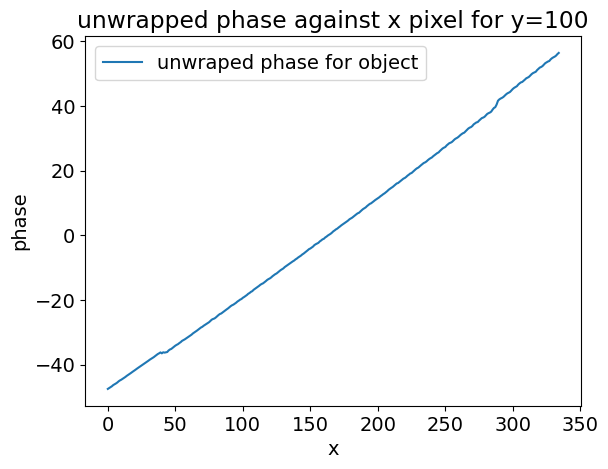

In [284]:
plt.figure()
x3 = np.linspace(0,334,335)

plt.plot(x3,q[100],label='unwraped phase for object')
plt.xlabel('x')
plt.ylabel('phase')
plt.title('unwrapped phase against x pixel for y=100')
plt.legend()
plt.savefig('img2.png')

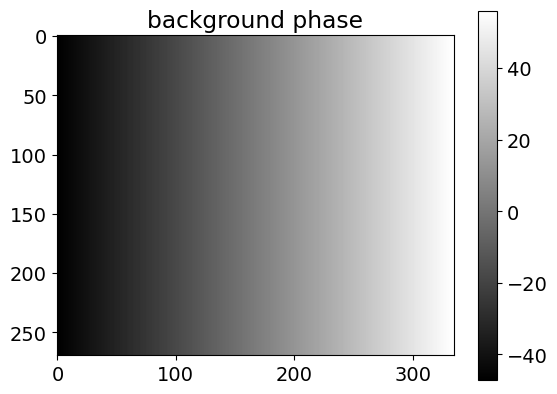

In [285]:
# calculate the average value as the background
y_means3 = np.mean((q[0:50]+q[220:])/2,axis=0)

# generate the background phase
phi_avg3 = np.tile(y_means3,(270,1))

plt.figure()
plt.imshow(phi_avg3,cmap='gray')
plt.axis('on')
plt.colorbar()
plt.title('background phase')
plt.savefig('background.png')

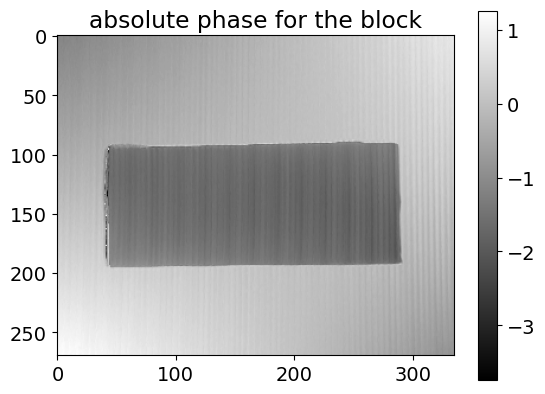

In [286]:
# calculate the unwrapped phase with the background removed
q_remove3 = q3 - phi_avg3

g = np.where(q_remove3>-1)
plt.figure()
plt.imshow(q_remove3, cmap = 'gray')
# Create a colorbar in the appended axes
plt.colorbar()
plt.title('absolute phase for the block')
plt.savefig('b_remove.png')

In [106]:
# save the phase map of the reference plane
# keep unchange
# DONT RUN
q_ref = q_remove3

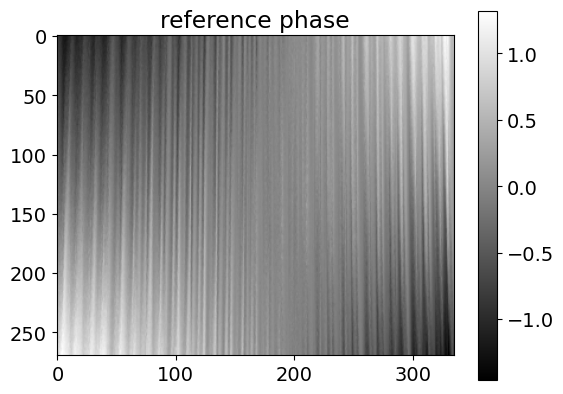

In [288]:
plt.figure()
plt.imshow(q_ref, cmap = 'gray')
plt.colorbar()
plt.title('reference phase')
plt.axis('on')
plt.savefig('reference.png')


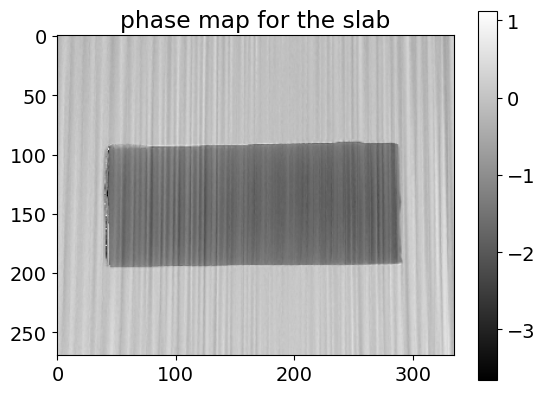

In [290]:
# calculate the phase of the slab exclusively
q_slab = q_remove3 - q_ref

plt.figure()
plt.imshow(q_slab, cmap = 'gray')

# Create a colorbar
plt.colorbar()
plt.title('phase map for the slab')
plt.savefig('slab.png')

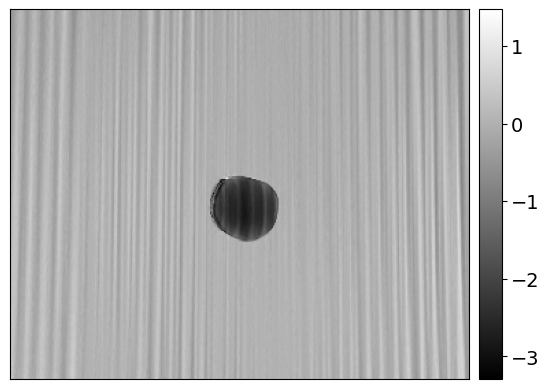

In [205]:
q_blu = q_remove3 - q_ref
b_mean = np.mean(q_blu[g[0],g[1]])
plt.figure()
plt.imshow(q_blu-b_mean, cmap = 'gray')

# Create a colorbar
plt.colorbar()
plt.title('phase map for the blu-tack')
plt.savefig('blu.png')



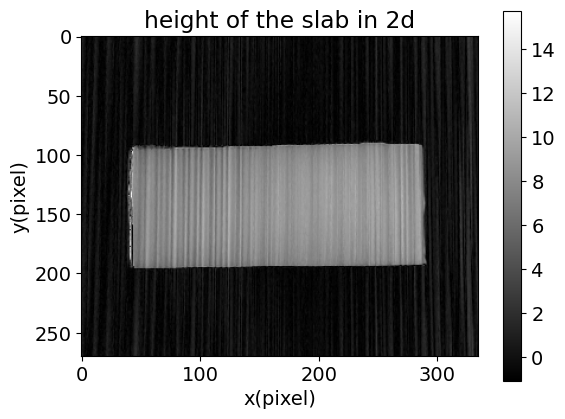

In [301]:
# calculate the height from phase-to-height correlation
hslab=1/(0.137/np.abs(q_slab)+0.022)
hrefs = np.mean(qr[k[0],k[1]])
hs = hslab-hrefs
plt.imshow(hs,cmap='gray')
plt.xlabel('x(pixel)')
plt.ylabel('y(pixel)')

plt.colorbar()
plt.title('height of the slab in 2d')
plt.savefig('h_blu.png')


Text(0.5, 1.0, 'height of the blu-tack in 2d')

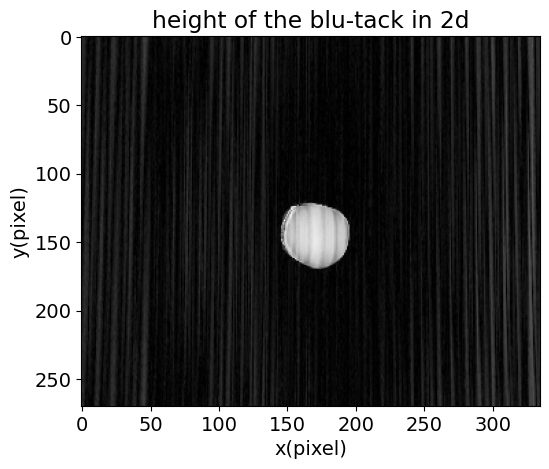

In [300]:
# calculate the height from phase-to-height correlation for blu-tack
hblu=1/(0.137/np.abs(q_blu)+0.022)
hrefb = np.mean(h[g[0],g[1]])
hb = hblu-hrefb
im = plt.imshow(hb,cmap='gray')
plt.xlabel('x(pixel)')
plt.ylabel('y(pixel)')

plt.colorbar(im, cax=cax)
plt.savefig('h_blu.png')
plt.title('height of the blu-tack in 2d')

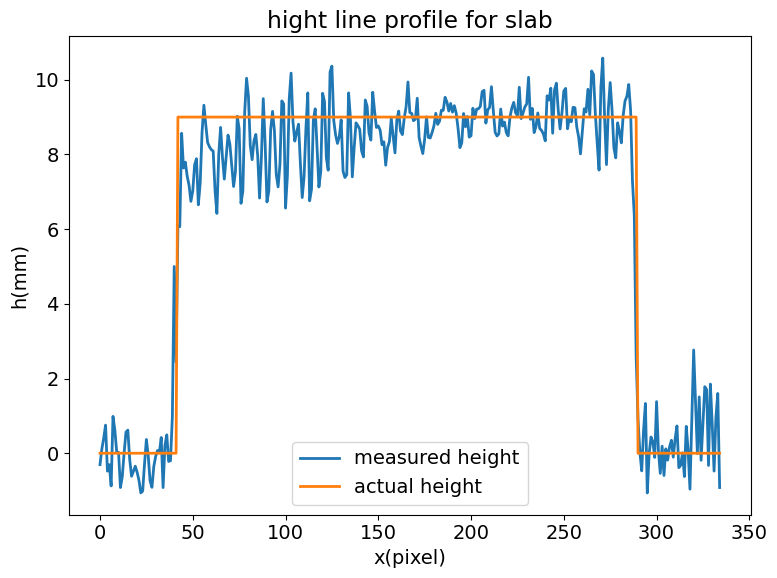

In [306]:

def slab_shape(x):
    n = len(x)
    y = np.linspace(0,334,335)
    y[0:42]=np.zeros(42)
    y[42:290]=np.ones(248) * 9
    y[290:]=np.zeros(45)
    return y

plt.figure(figsize=(8, 6))  # Set a larger figure size for better visibility

# Increase default font sizes for the plot
plt.rcParams.update({'font.size': 14})

# Plot wrapped and unwrapped phase with increased line width and markers
plt.plot(np.linspace(0, 334, 335), hs[150],label='measured height', linewidth=2, markersize=5)
plt.plot(np.linspace(0, 334, 335), slab_shape(np.linspace(0, 334, 335)),label='actual height', linewidth=2, markersize=5)

# Add grid, labels, title, and legend
plt.grid(False)  # Add grid lines for better readability
plt.xlabel('x(pixel)')  # Replace with your actual x-axis label and units
plt.ylabel('h(mm)')  # Replace with your actual y-axis label and units
plt.title('hight line profile for slab')  # Replace with your actual title
plt.legend()  # Display legend to identify the lines

plt.tight_layout()  # Adjust layout to prevent clipping of labels/title
plt.savefig('height.png')

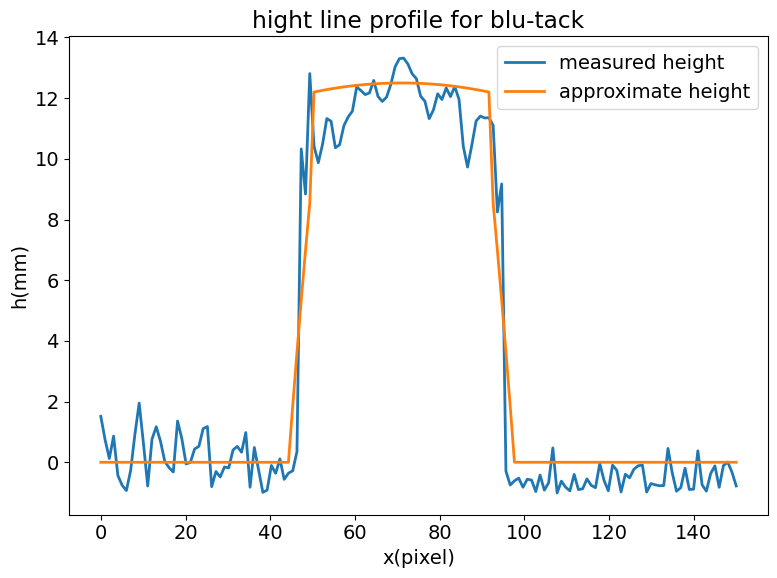

In [304]:

def blu_shape(x):
    
    y = np.linspace(0,334,150)
    y[0:45]=np.zeros(45)
    
    y[97:]=np.zeros(53)
    y[44:98]= -25 * (x)**2 +25
    y[50:92]= -0.5 * (x[6:48])**2 +12.5
    return y

plt.figure(figsize=(8, 6))  # Set a larger figure size for better visibility

# Increase default font sizes for the plot
plt.rcParams.update({'font.size': 14})

# Plot wrapped and unwrapped phase with increased line width and markers
plt.plot(np.linspace(0, 150, 150), hb[150][100:250],label='measured height', linewidth=2, markersize=5)
plt.plot(np.linspace(0, 150, 150), blu_shape(np.linspace(-1, 1, 54)),label='approximate height', linewidth=2, markersize=5)

# Add grid, labels, title, and legend
plt.grid(False)  # Add grid lines for better readability
plt.xlabel('x(pixel)')  # Replace with your actual x-axis label and units
plt.ylabel('h(mm)')  # Replace with your actual y-axis label and units
plt.title('hight line profile for blu-tack')  # Replace with your actual title
plt.legend()  # Display legend to identify the lines

plt.tight_layout()  # Adjust layout to prevent clipping of labels/title
plt.savefig('height.png')

In [305]:
import plotly.graph_objects as go
import numpy as np
import plotly.io as pio

# Assuming 'qr' contains your z-coordinates

coordsx = np.linspace(0, 335, qr.shape[1])
coordsy = np.linspace(0, 270, qr.shape[0])
x, y = np.meshgrid(coordsx, coordsy)

fig2 = go.Figure(data=[go.Surface(z=hs, x=x, y=y)])

# Update the figure with z-axis label and fix the title orientation
fig2.update_layout(
    title={
        'text': '3D Surface for slab',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    autosize=False,
    width=700,
    height=700,
    margin=dict(l=80, r=65, b=80, t=90),
    paper_bgcolor='white',
    plot_bgcolor='white',
    scene=dict(
        xaxis=dict(backgroundcolor='white', color='black', gridcolor='grey',title='x(pixel)'),
        yaxis=dict(backgroundcolor='white', color='black', gridcolor='grey',title='y(pixel)'),
        zaxis=dict(backgroundcolor='white', color='black', gridcolor='grey', title='h(mm)')  # Set z-axis label
    )
)

# Save the figure
pio.write_image(fig2, '3dsurface.png')

# If running in an interactive environment (like Jupyter), this will display the figure
fig2.show()

In [298]:
import plotly.graph_objects as go
import numpy as np
import plotly.io as pio

# Assuming 'qr' contains your z-coordinates

coordsx = np.linspace(0, 335, qr.shape[1])
coordsy = np.linspace(0, 270, qr.shape[0])
x, y = np.meshgrid(coordsx, coordsy)

fig2 = go.Figure(data=[go.Surface(z=hb[100:200,100:250], x=x, y=y)])

# Update the figure with z-axis label and fix the title orientation
fig2.update_layout(
    title={
        'text': '3D surface for blu-tack',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    autosize=False,
    width=700,
    height=700,
    margin=dict(l=80, r=65, b=80, t=90),
    paper_bgcolor='white',
    plot_bgcolor='white',
    scene=dict(
        xaxis=dict(backgroundcolor='white', color='black', gridcolor='grey',title='x(pixel)'),
        yaxis=dict(backgroundcolor='white', color='black', gridcolor='grey',title='y(pixel)'),
        zaxis=dict(backgroundcolor='white', color='black', gridcolor='grey', title='h(mm)')  # Set z-axis label
    )
)

# Save the figure
pio.write_image(fig2, '3dsurface.png')

# If running in an interactive environment (like Jupyter), this will display the figure
fig2.show()

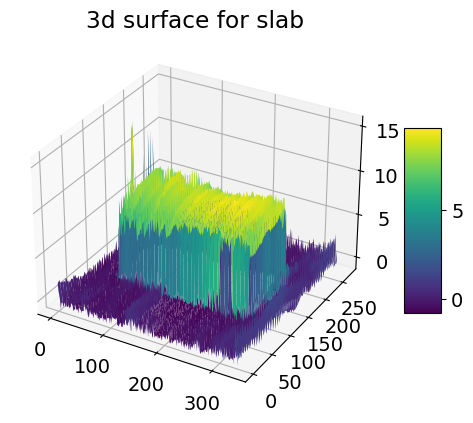

In [308]:
from matplotlib import cm

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(x, y, hs, cmap=cm.viridis)
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.title('3d surface for slab')
plt.show()
